In [1]:
from Bio import pairwise2
from Bio.Seq import Seq
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import re
import seaborn as sns 
import random
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
import scipy.cluster.hierarchy as shc
from matplotlib.colors import ListedColormap

/Users/DBurke/anaconda3/lib/python3.10/site-packages/Bio/pairwise2.py:278: BiopythonDeprecationWarning: Bio.pairwise2 has been deprecated, and we intend to remove it in a future release of Biopython. As an alternative, please consider using Bio.Align.PairwiseAligner as a replacement, and contact the Biopython developers if you still need the Bio.pairwise2 module.
  warnings.warn(


In [2]:
species = "horse"
bed_file = 'horse/'+'sep1_244_gene_ant.bed' # contains loci for all sep1 coordinates
base_bed_file = 'horse/gene_ant_full.txt'
results_file = 'horse/'+'v2output_sep1.txt'# contains VCF info for every sample that has SV in one of the identified coordinates

In [3]:
colors = {'PRZEWALSKI' : 'red', 'AKHAL-TEKE' : 'blue', 'ARABIAN' : 'green', \
          'QUARTER HORSE' : 'yellow', "MONGOLIAN" : "brown", "THOROUGHBRED" : 'orange', \
          'FRIESIAN' : 'black', 'HANOVARIAN' : 'pink', 'JEJU HORSE' : 'gray', \
          'CURLY HORSE' : 'purple', 'DEBAO' : 'teal', 'CRIOLLO' : 'tan'}

In [4]:
gene_count = {}
with open(base_bed_file) as f:
    lines = f.readlines()
    for line in lines:
        s = 'asdf=5;iwantthis123jasd'
        try:
            name = re.search('gene_name (.*); gene_source', line).group(1)
            name=name.strip('"')
            if name not in gene_count.keys():
                gene_count[name] = 1
            else:
                gene_count[name] += 1 
        except:
            continue

In [5]:
print(len(gene_count.keys()))

372


/var/folders/wr/4rqnvky57y35yvhv5by1523m0000gn/T/ipykernel_12054/4254891398.py:52: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.subplots(figsize=(20,15))


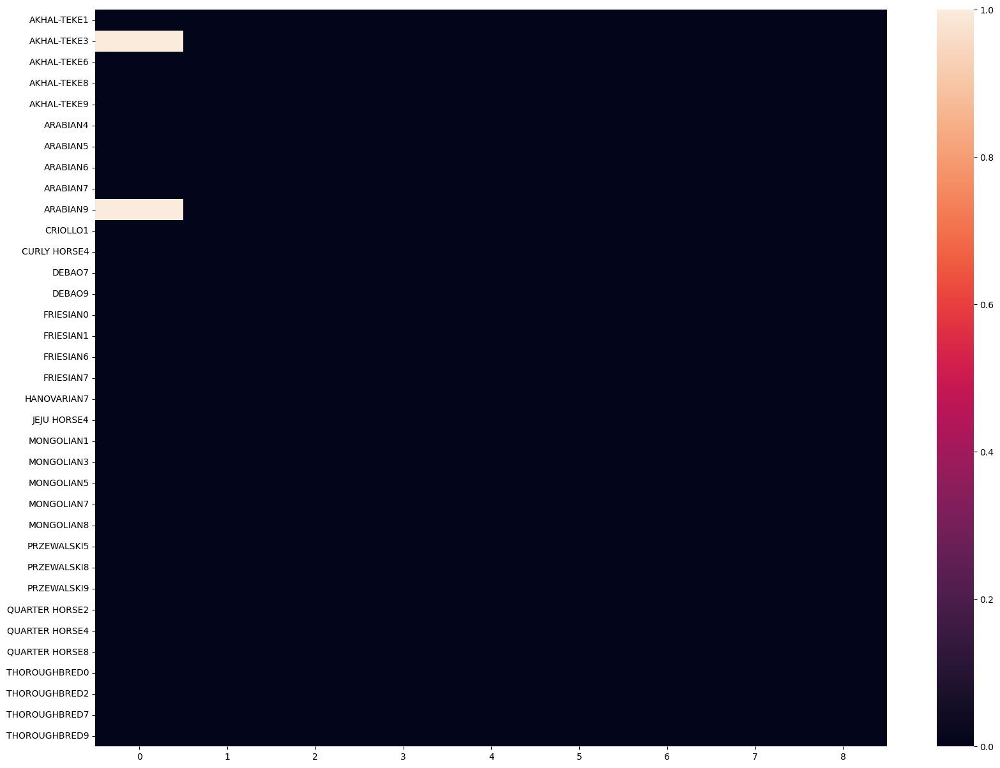

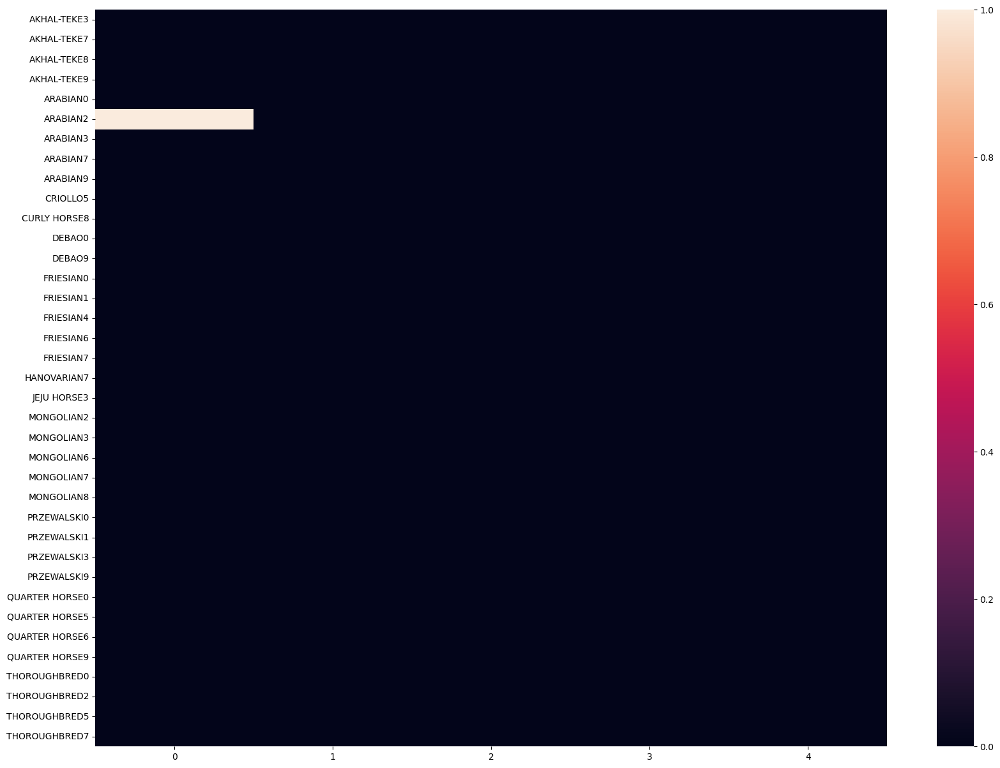

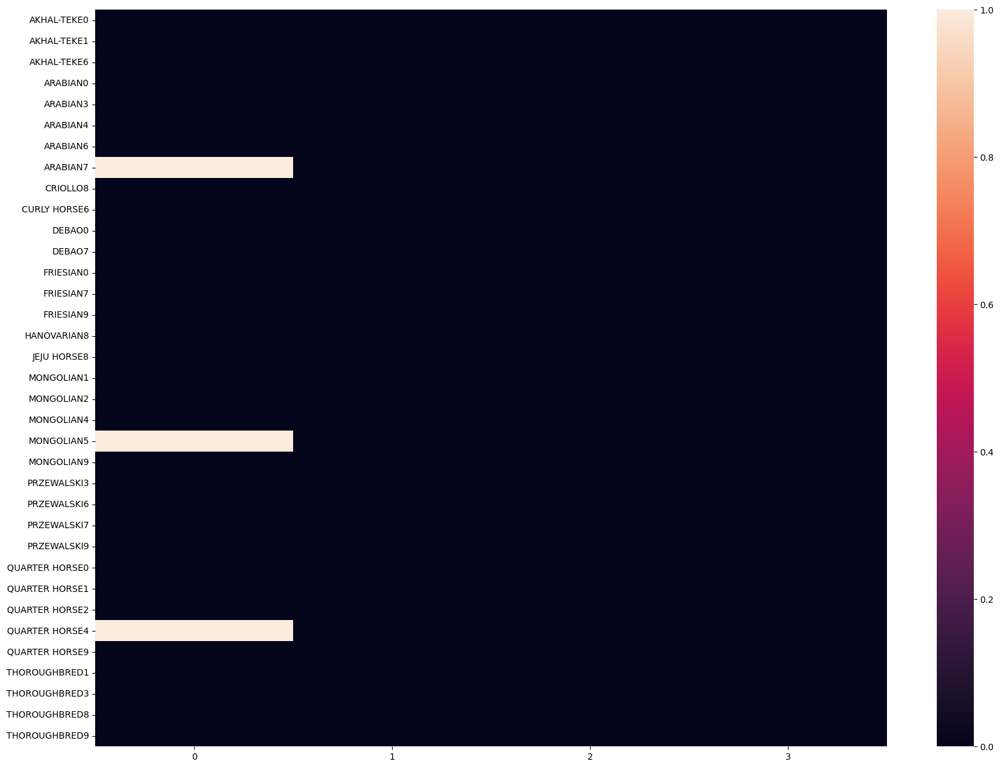

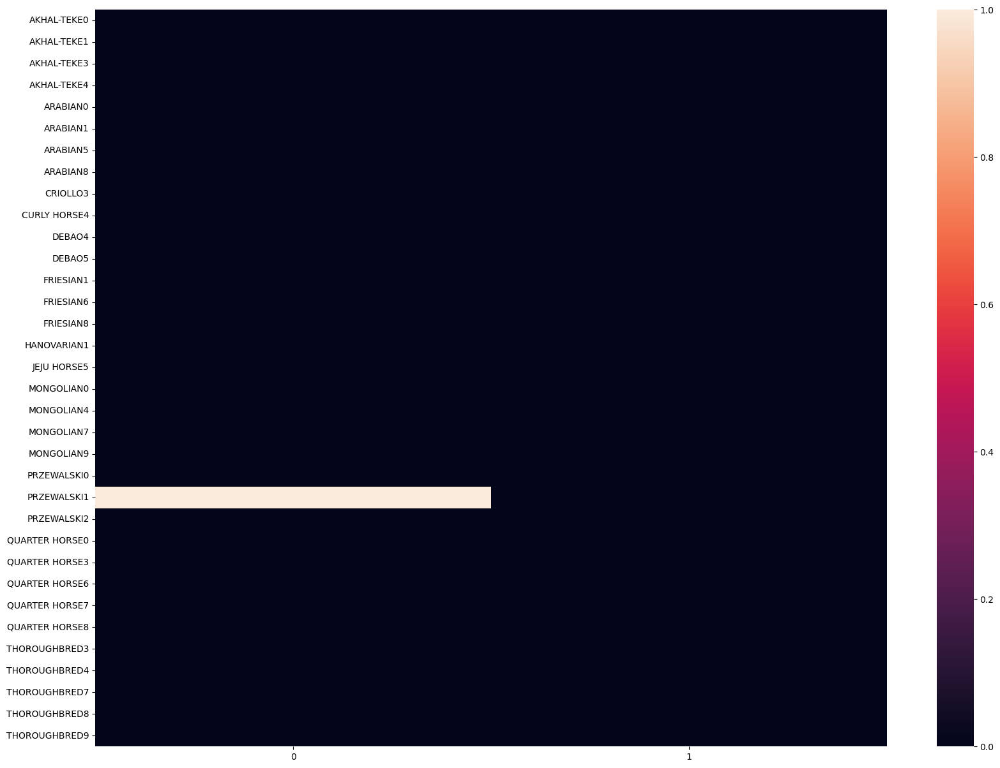

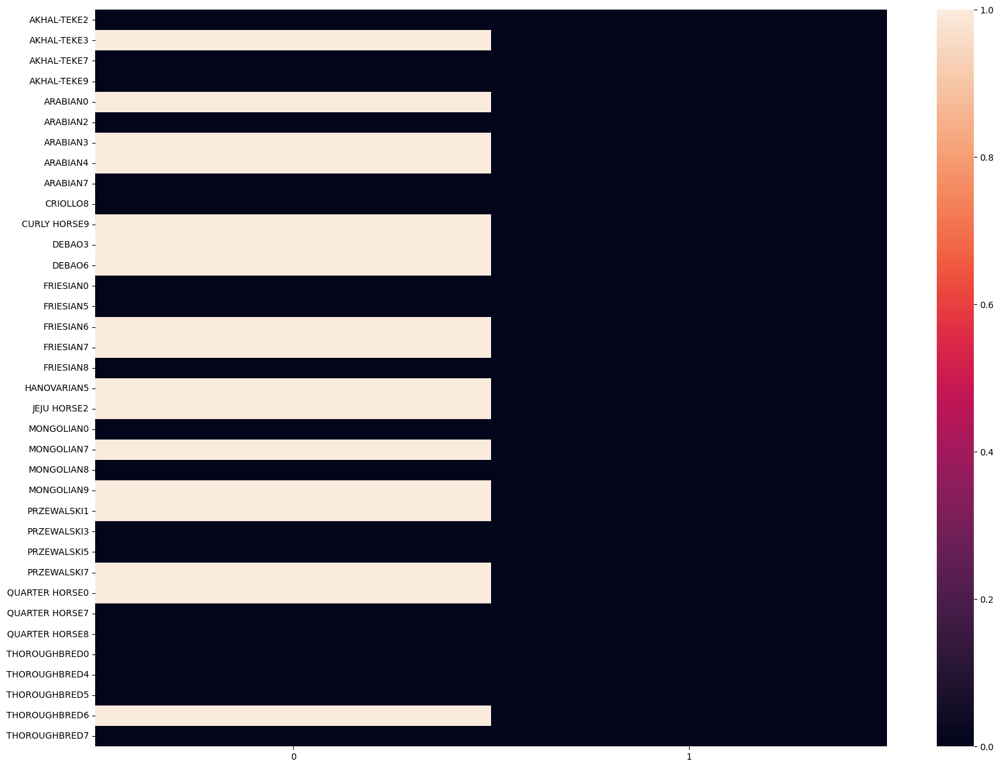

...

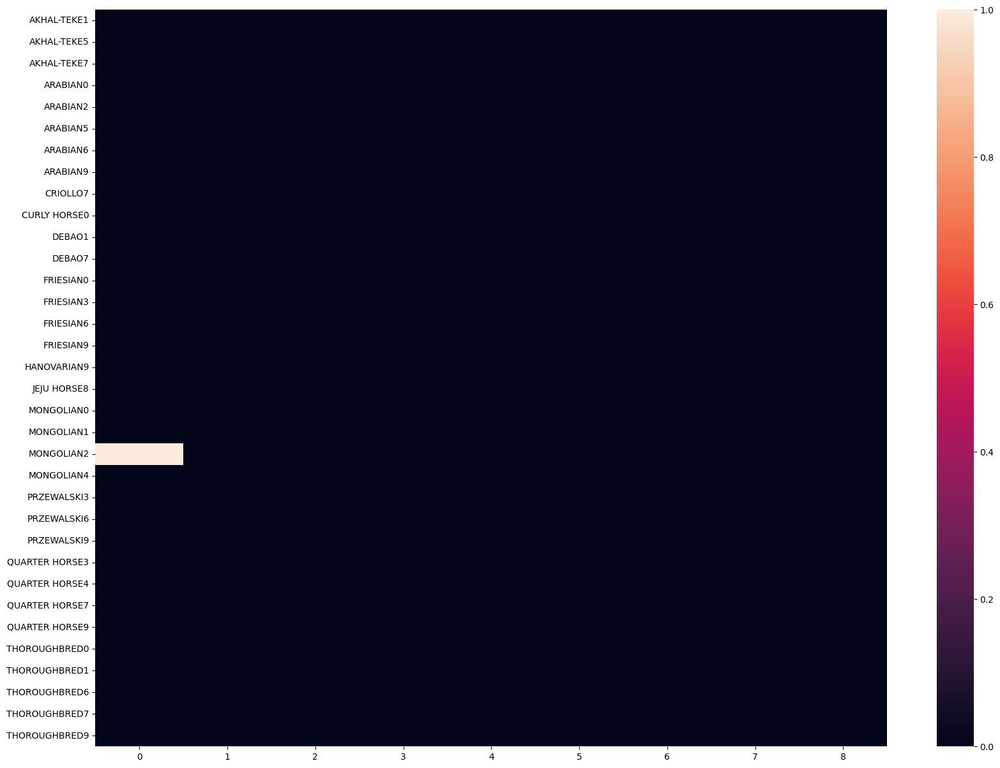

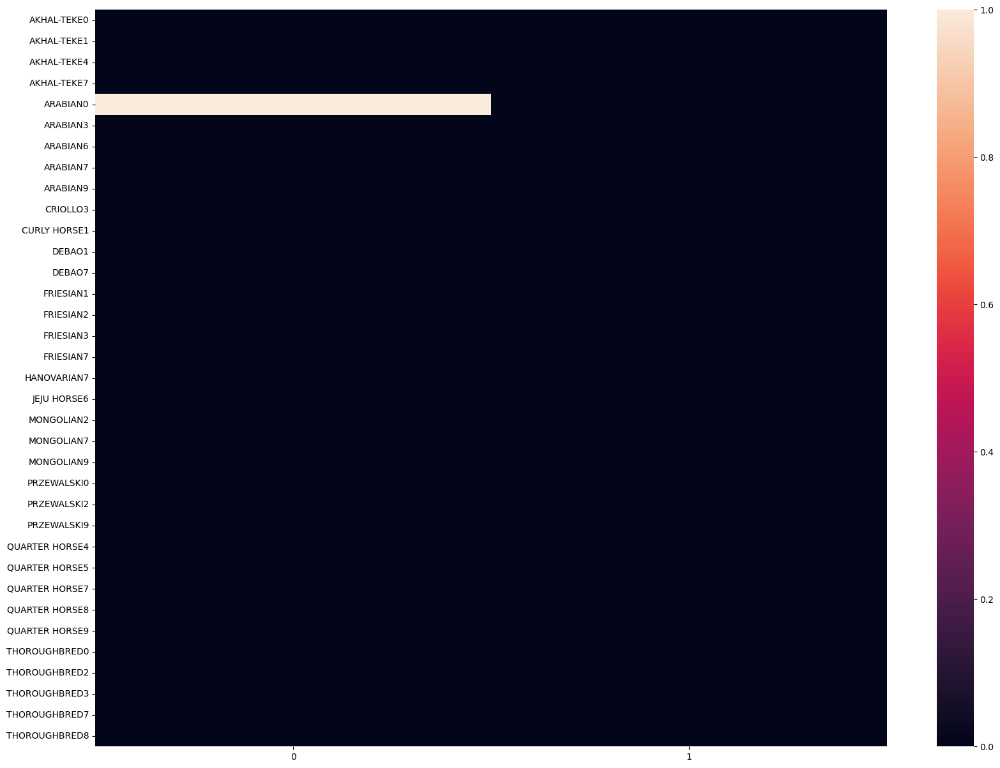

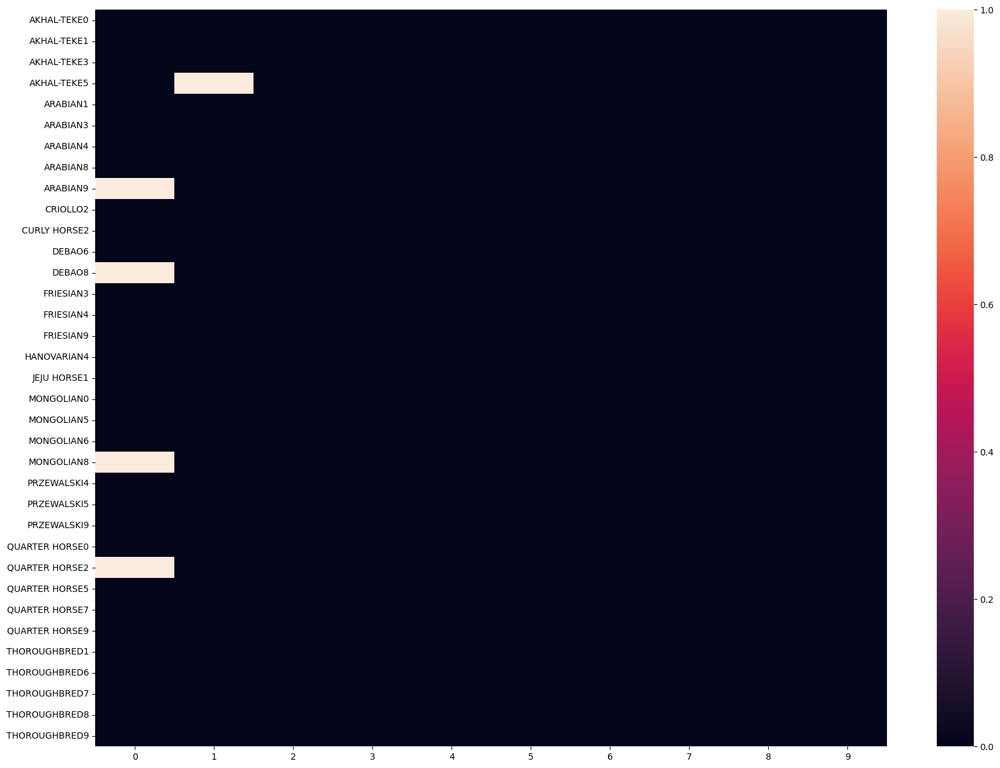

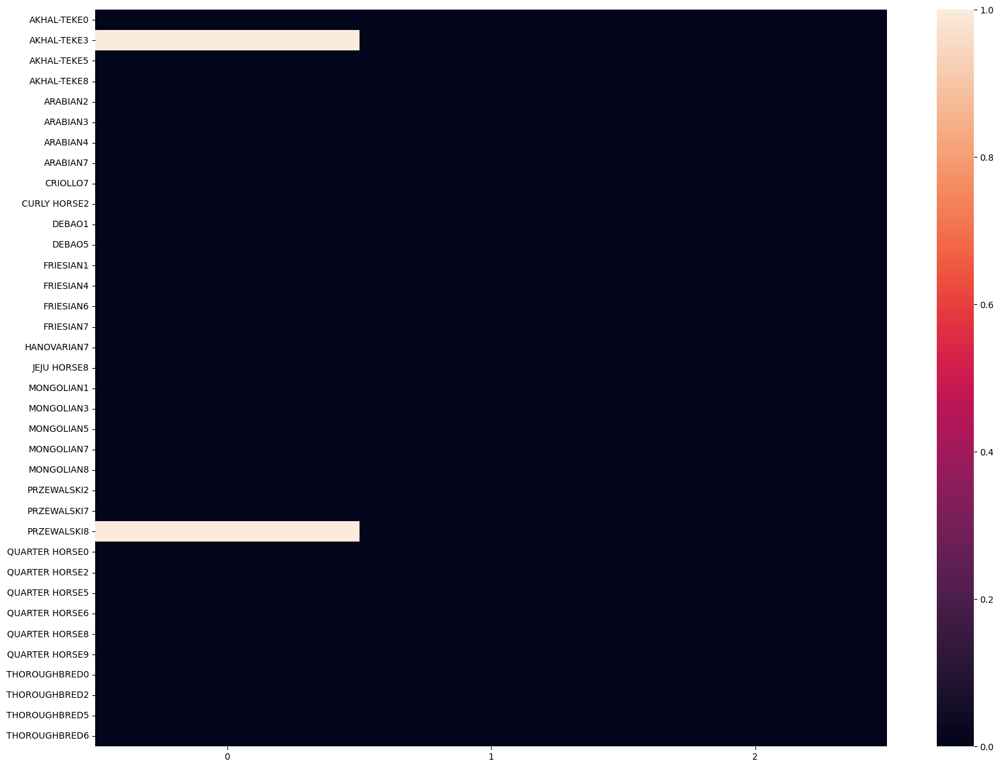

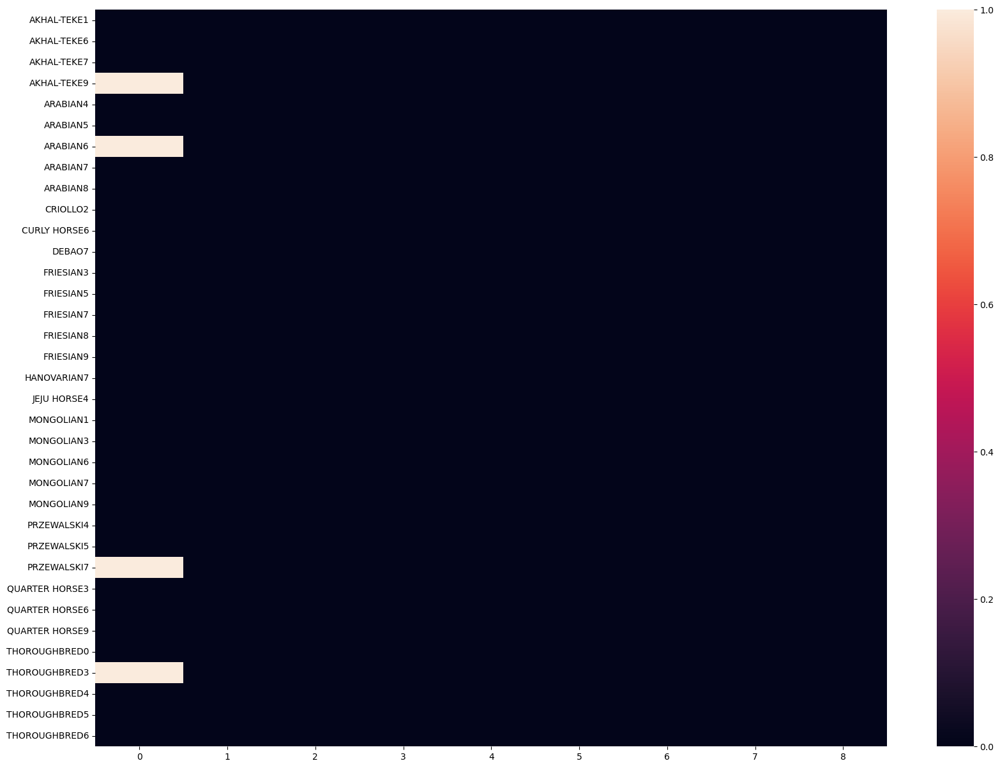

In [11]:
# get all loci
targets = list(gene_count.keys())[0:200]
#targets = ['']
for target in targets:
    entries = []
    gene_names = []
    with open(bed_file) as f:
        lines = f.readlines()
        for line in lines: #
            line = line.split()
            end = int(line[1]) + int(line[2])
            if line[-1:][0] == target:
                gene_names.append(line[-1:])
                t = ">"+line[0]+":"+line[1]+"-"+str(line[1])
                entries.append(t)
    meta_data = pd.read_csv('horse/horse_sra_simple.csv')
    #print(meta_data)
    meta_data.columns = ['sra','breed']
    color_col = []
    for index, row in meta_data.iterrows():
        row['breed'] = row['breed'] + str(random.randint(0,9))
    samples = {}
    index = 0
    with open(results_file) as f:
        lines = f.readlines()
        for line in lines:
            if "output" in line:
                sample_name = line.split('/')[1].strip()
                breed_name = meta_data.loc[meta_data['sra'] == sample_name]
                #print(breed_name, sample_name)
                breed_name = breed_name['breed'].values[0]
                samples[breed_name] = np.zeros(len(entries))
            else:
                t = line.split()
                chrom = t[0]
                start = t[1]
                end = start
                seq = re.search('SVINSSEQ=(.*);SPLIT_READS',line)
                seq = seq.group(1)
                s = ">"+chrom+":"+start+"-"+end
                
                if s in entries and chrom not in  ['']: # SV is in TE loci, get percent identify to cons seq
                    idx = entries.index(s)
                    samples[breed_name][idx] += 1
    df=pd.DataFrame.from_dict(samples,orient='index').transpose()
    cols = list(df.columns.values)
    cols = sorted(cols, key=str.lower)
    df_new = df[cols]
    #df_final = df_new.iloc[0:905]
    df_final = df_new
    df_final = df_final.transpose()
    plt.subplots(figsize=(20,15))
    sns.heatmap(df_final)
    plt.savefig("plot{}.png".format(target))

<Axes: >

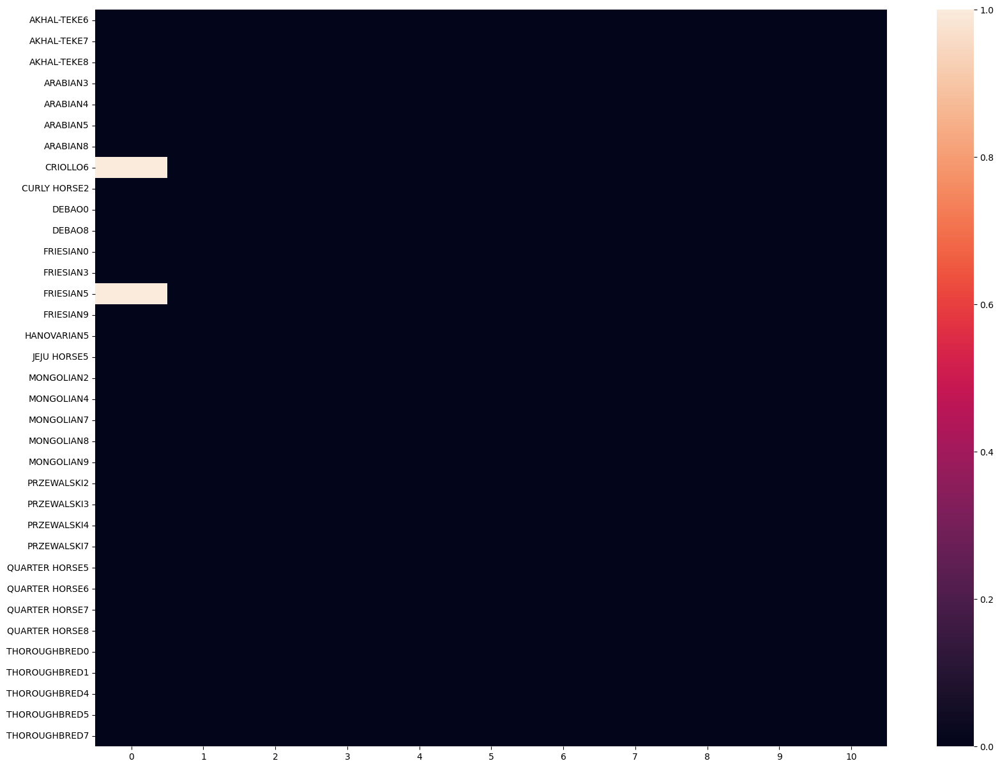

In [7]:
samples = {}
index = 0
with open(results_file) as f:
    lines = f.readlines()
    for line in lines:
        if "output" in line:
            sample_name = line.split('/')[1].strip()
            breed_name = meta_data.loc[meta_data['sra'] == sample_name]
            #print(breed_name, sample_name)
            breed_name = breed_name['breed'].values[0]
            samples[breed_name] = np.zeros(len(entries)) 
        else:
            t = line.split()
            chrom = t[0]
            start = t[1]
            end = start
            seq = re.search('SVINSSEQ=(.*);SPLIT_READS',line)
            seq = seq.group(1)
            s = ">"+chrom+":"+start+"-"+end
            if s in entries and chrom not in  ['X', 'Y']: # SV is in TE loci, get percent identify to cons seq
                idx = entries.index(s)
                samples[breed_name][idx] += 1
df=pd.DataFrame.from_dict(samples,orient='index').transpose()
cols = list(df.columns.values)
cols = sorted(cols, key=str.lower)
df_new = df[cols]
#df_final = df_new.iloc[0:905]
df_final = df_new
df_final = df_final.transpose()
plt.subplots(figsize=(20,15))
sns.heatmap(df_final)

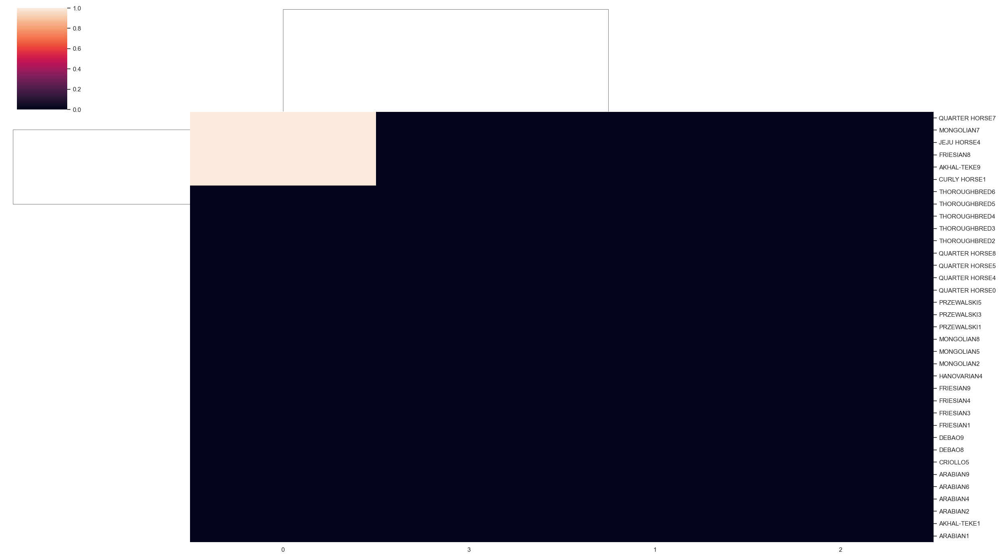

In [129]:
ls = sns.clustermap(df_final,figsize=(25,14))
fig = ls.fig

In [95]:
pca = PCA(n_components=2)
X = np.array(list(samples.values()))
y = list(samples.keys())
x_scaled = StandardScaler().fit_transform(X)
pca_features = pca.fit_transform(x_scaled)
pca_df = pd.DataFrame(
    data=pca_features, 
    columns=['PC1', 'PC2'])
pca_df['target'] = y
t = list(pca_df['target'].values)
cs = [colors[i[:-1]] for i in t] 
pca_df['colors'] = cs

In [96]:
X = df_final.loc[:].values
x_scaled = StandardScaler().fit_transform(X)
y = list(df_final.index)
pca = PCA(n_components=2)
pca_features = pca.fit_transform(x_scaled)
## Create dataframe
pca_df = pd.DataFrame(
    data=pca_features, 
    columns=['PC1', 'PC2'])
pca_df['target'] = y
t = list(pca_df['target'].values)
cs = [colors[i[:-1]] for i in t] 
pca_df['colors'] = cs
c_dict = dict(zip(pca_df.target, pca_df.colors))
print(pca_df)

         PC1       PC2          target  colors
0  -1.400736 -0.272584     AKHAL-TEKE0    blue
1  -1.400736 -0.272584     AKHAL-TEKE2    blue
2   1.484020 -0.288791     AKHAL-TEKE3    blue
3  -1.400736 -0.272584     AKHAL-TEKE6    blue
4   0.033538  1.161690        ARABIAN2   green
5  -1.400736 -0.272584        ARABIAN3   green
6  -1.400736 -0.272584        ARABIAN4   green
7   0.033538  1.161690        ARABIAN5   green
8  -1.400736 -0.272584        ARABIAN7   green
9  -1.400736 -0.272584        CRIOLLO8     tan
10  0.033538  1.161690    CURLY HORSE3  purple
11  0.033538  1.161690          DEBAO7    teal
12 -1.400736 -0.272584          DEBAO8    teal
13 -1.400736 -0.272584       FRIESIAN0   black
14 -1.400736 -0.272584       FRIESIAN3   black
15 -1.400736 -0.272584       FRIESIAN4   black
16 -1.400736 -0.272584       FRIESIAN5   black
17 -1.400736 -0.272584       FRIESIAN8   black
18  1.484020 -0.288791     HANOVARIAN5    pink
19  1.484020 -0.288791     JEJU HORSE6    gray
20 -1.400736 

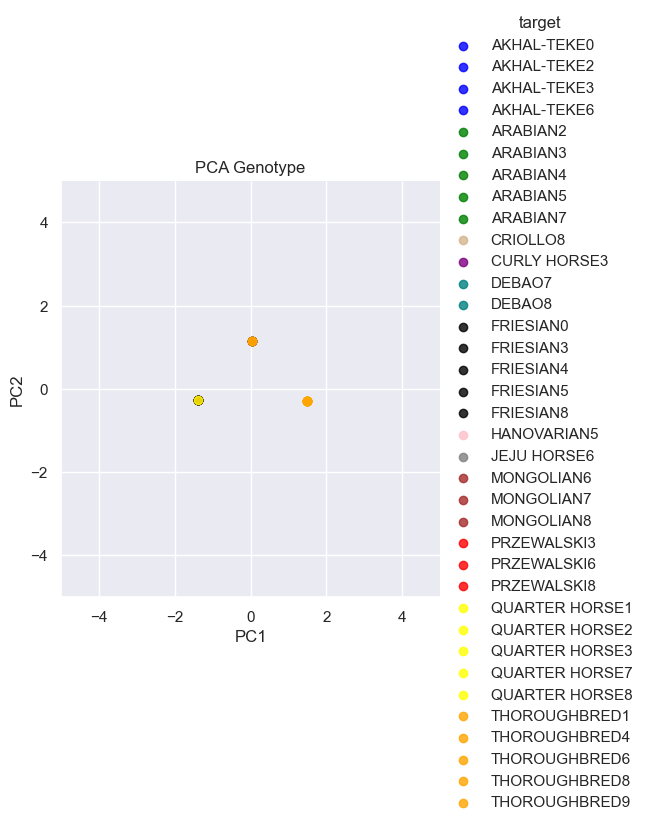

In [97]:
import seaborn as sns
sns.set()
 
ls = sns.lmplot(
    x='PC1', 
    y='PC2', 
    data=pca_df, 
    palette=c_dict,
    hue='target',
    fit_reg=False, 
    legend=True
    )
ls = (ls.set_axis_labels("PC1","PC2").set(xlim=(-5,5),ylim=(-5,5)))
plt.title('PCA ERE1 Type')
plt.title('PCA Genotype')
plt.show()